In [2]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
from ydata_profiling import ProfileReport
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np


In [ ]:
# Load the CSV file to understand its structure
file_path = "/Users/vinoth/Library/Mobile Documents/com~apple~CloudDocs/Job Assignment/Red Cloud Technology/technical_challenge/challenge_dataset.csv"
data = pd.read_csv(file_path)

# Display the first few rows of the dataset to understand its structure
data.head(), data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4661 entries, 0 to 4660
Data columns (total 18 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   4661 non-null   int64  
 1   Tenure                       4430 non-null   float64
 2   PreferredLoginDevice         4661 non-null   object 
 3   CityTier                     4661 non-null   int64  
 4   WarehouseToHome              4444 non-null   float64
 5   PreferredPaymentMode         4661 non-null   object 
 6   HourSpendOnApp               4453 non-null   float64
 7   NumberOfDeviceRegistered     4661 non-null   int64  
 8   PreferedOrderCat             4577 non-null   object 
 9   SatisfactionScore            4283 non-null   float64
 10  NumberOfAddress              4661 non-null   int64  
 11  Complain                     4559 non-null   float64
 12  OrderAmountHikeFromlastYear  4429 non-null   float64
 13  CouponUsed        

(   CustomerID  Tenure PreferredLoginDevice  CityTier  WarehouseToHome  \
 0       55388     5.0         Mobile Phone         1              9.0   
 1       52565     2.0                Phone         1             15.0   
 2       50690    13.0         Mobile Phone         1             20.0   
 3       52456     NaN                Phone         1              8.0   
 4       51153    19.0         Mobile Phone         1              8.0   
 
   PreferredPaymentMode  HourSpendOnApp  NumberOfDeviceRegistered  \
 0           Debit Card             4.0                         4   
 1                   CC             NaN                         3   
 2          Credit Card             2.0                         4   
 3           Debit Card             3.0                         3   
 4          Credit Card             2.0                         3   
 
   PreferedOrderCat  SatisfactionScore  NumberOfAddress  Complain  \
 0     Mobile Phone                3.0                3       0.0   


In [4]:
# Total rows before dropping NaN
print("Total rows before drop:", data.shape[0])

# Drop rows with NaN in the 'Churn' column inplace
data.dropna(subset=['Churn'], inplace=True)

# Total rows after dropping NaN
print("Total rows after drop:", data.shape[0])


Total rows before drop: 4661
Total rows after drop: 4634


In [5]:
duplicate_rows = data[data.duplicated()]
print("Duplicate Rows (Default):")
print(duplicate_rows)


Duplicate Rows (Default):
      CustomerID  Tenure PreferredLoginDevice  CityTier  WarehouseToHome  \
158        55079    25.0             Computer         3             16.0   
198        53526     9.0         Mobile Phone         2             15.0   
236        54523     1.0             Computer         3             16.0   
351        53831    18.0         Mobile Phone         1             14.0   
732        52984     1.0         Mobile Phone         3             11.0   
...          ...     ...                  ...       ...              ...   
4448       53042     6.0                Phone         1              9.0   
4469       55268    12.0             Computer         2             17.0   
4503       50207     0.0             Computer         3              6.0   
4561       53644     8.0                Phone         1             10.0   
4622       50848     NaN             Computer         1              6.0   

     PreferredPaymentMode  HourSpendOnApp  NumberOfDeviceRegi

In [6]:
data.drop_duplicates(subset=None, keep='first', inplace=True)


In [7]:
# Replace values in PreferredLoginDevice
data['PreferredLoginDevice'] = data['PreferredLoginDevice'].replace('Mobile Phone', 'Phone')

# Replace values in PreferedOrderCat
data['PreferedOrderCat'] = data['PreferedOrderCat'].replace(['Mobile Phone', 'Mobile'], 'Phone')

data['PreferredPaymentMode'] = data['PreferredPaymentMode'].replace(['CC'], 'Credit Card')

data['PreferredPaymentMode'] = data['PreferredPaymentMode'].replace(['COD'], 'Cash on Delivery')

In [ ]:
# Update the column with the value for each duplicate records which has missing value
data['Tenure'] = data.groupby('CustomerID')['Tenure'].transform('max')
data['OrderCount'] = data.groupby('CustomerID')['OrderCount'].transform('max')
data['HourSpendOnApp'] = data.groupby('CustomerID')['HourSpendOnApp'].transform('max')
data['SatisfactionScore'] = data.groupby('CustomerID')['SatisfactionScore'].transform('max')
data['CashbackAmount'] = data.groupby('CustomerID')['CashbackAmount'].transform('max')
data['Complain'] = data.groupby('CustomerID')['Complain'].transform('max')
data.dropna(subset=['PreferedOrderCat'], inplace=True)
data['SatisfactionScore'].fillna(0, inplace=True)
# Replace satisfaction score values with corresponding text ratings
satisfaction_mapping = {
    0: "Unrated",
    1: "Very Dissatisfied",
    2: "Dissatisfied",
    3: "Neutral",
    4: "Satisfied",
    5: "Very Satisfied"
}

# Replace the values in the SatisfactionScore column
data['SatisfactionScoreText'] = data['SatisfactionScore'].map(satisfaction_mapping)

# Display the updated column with text ratings
data[['SatisfactionScore', 'SatisfactionScoreText']].head()


,SatisfactionScore,SatisfactionScoreText
0,3.0,Neutral
1,3.0,Neutral
2,3.0,Neutral
3,5.0,Very Satisfied
4,1.0,Very Dissatisfied


In [9]:
data[data['CustomerID']==50328]

,CustomerID,Tenure,PreferredLoginDevice,CityTier,WarehouseToHome,PreferredPaymentMode,HourSpendOnApp,NumberOfDeviceRegistered,PreferedOrderCat,SatisfactionScore,NumberOfAddress,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount,Churn,SatisfactionScoreText
2684,50328,18.0,Phone,3,8.0,UPI,3.0,3,Laptop & Accessory,4.0,1,0.0,19.0,3.0,3.0,7.0,148.05,0.0,Satisfied


In [10]:
data.drop_duplicates(subset=None, keep='first', inplace=True)

In [11]:
duplicates = data['CustomerID'].value_counts()
more_than_one = duplicates[duplicates > 1].index
print("CustomerIDs with more than one occurrence:")
print(more_than_one)


CustomerIDs with more than one occurrence:
Index([], dtype='int64', name='CustomerID')


In [12]:
df_duplicates = data[data['CustomerID'].isin(more_than_one)]
print("Rows for CustomerIDs with more than one occurrence:")
print(df_duplicates)


Rows for CustomerIDs with more than one occurrence:
Empty DataFrame
Columns: [CustomerID, Tenure, PreferredLoginDevice, CityTier, WarehouseToHome, PreferredPaymentMode, HourSpendOnApp, NumberOfDeviceRegistered, PreferedOrderCat, SatisfactionScore, NumberOfAddress, Complain, OrderAmountHikeFromlastYear, CouponUsed, OrderCount, DaySinceLastOrder, CashbackAmount, Churn, SatisfactionScoreText]
Index: []


In [13]:
# Save the cleaned dataset for future use
cleaned_file_path = '/Users/vinoth/Library/Mobile Documents/com~apple~CloudDocs/Job Assignment/Red Cloud Technology/technical_challenge/cleaned_challenge_dataset.csv'
data.to_csv(cleaned_file_path, index=False)


cleaned_file_path

'/Users/vinoth/Library/Mobile Documents/com~apple~CloudDocs/Job Assignment/Red Cloud Technology/technical_challenge/cleaned_challenge_dataset.csv'

### Duplicate records is cleaned so far

# Task 1 - EDA

#### Tenure vs Churn Rate

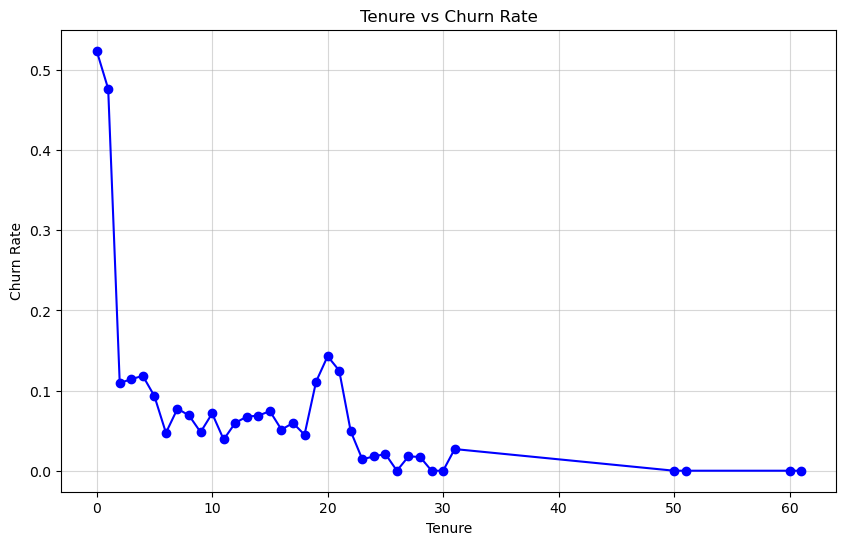

In [14]:
# Calculate churn rate by tenure
tenure_churn_rate = data.groupby('Tenure')['Churn'].mean()

# Plot tenure vs churn rate
plt.figure(figsize=(10, 6))
plt.plot(tenure_churn_rate.index, tenure_churn_rate.values, marker='o', linestyle='-', color='blue')
plt.title("Tenure vs Churn Rate")
plt.xlabel("Tenure")
plt.ylabel("Churn Rate")
plt.grid(alpha=0.5)
plt.show()


### Insights on Churn and Tenure

The analysis reveals that customers with shorter tenures are more likely to churn. This trend highlights the importance of targeting retention efforts towards newer customers to reduce churn rates.


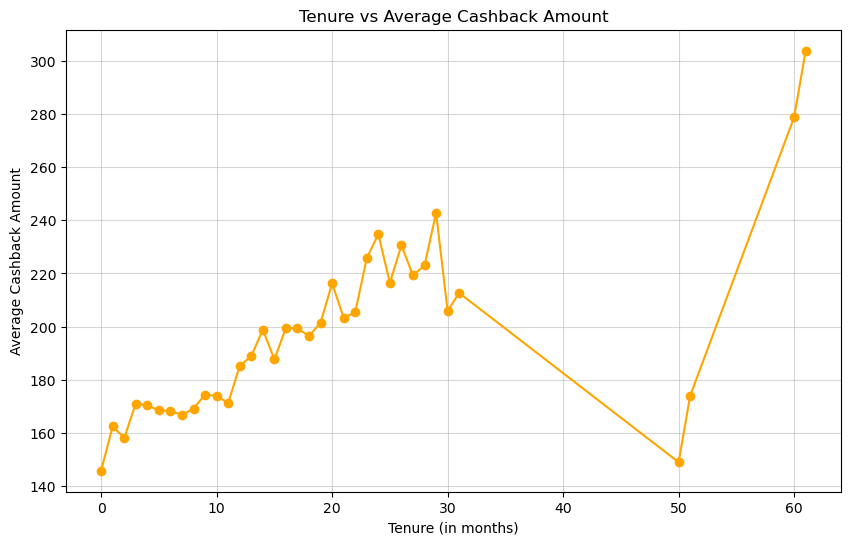

Tenure
0.0    145.798414
1.0    162.487438
2.0    158.140078
3.0    171.054571
4.0    170.365629
5.0    168.523625
6.0    168.252671
7.0    166.786310
8.0    169.167065
9.0    174.426364
Name: CashbackAmount, dtype: float64

In [15]:
# Calculate average cashback amount for each tenure value
cashback_vs_tenure = data.groupby('Tenure')['CashbackAmount'].mean()

# Plot the relationship
plt.figure(figsize=(10, 6))
plt.plot(cashback_vs_tenure.index, cashback_vs_tenure.values, marker='o', linestyle='-', color='orange')
plt.title("Tenure vs Average Cashback Amount")
plt.xlabel("Tenure (in months)")
plt.ylabel("Average Cashback Amount")
plt.grid(alpha=0.5)
plt.show()

# Display the underlying values for reference
cashback_vs_tenure.head(10)  # Showing the first 10 tenures for clarity


# Tenure and Cashback Analysis

### Observations
- **Cashback Trends**: Cashback increases with tenure, rewarding long-term customers.
- **Churn vs Tenure**: Churn reduces significantly after the first two years.

### Key Takeaway
- Offering **higher cashback** in the first two years can reduce churn and encourage long-term customer retention.
- Data cleary **shows outliers**


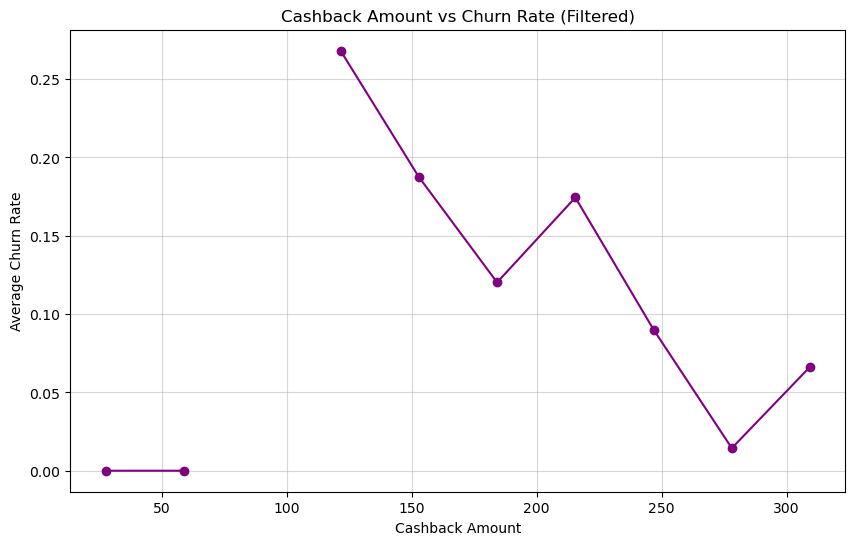

CashbackBins
(11.687, 43.299]      0.000000
(43.299, 74.598]      0.000000
(74.598, 105.897]          NaN
(105.897, 137.196]    0.268135
(137.196, 168.495]    0.187537
(168.495, 199.794]    0.120225
(199.794, 231.093]    0.174447
(231.093, 262.392]    0.090090
(262.392, 293.691]    0.014423
(293.691, 324.99]     0.066351
Name: Churn, dtype: float64

In [16]:
# Filter out negative cashback values and recalculate churn rate for cashback bins
filtered_data = data[data['CashbackAmount'] > 0]
filtered_data['CashbackBins'] = pd.cut(filtered_data['CashbackAmount'], bins=10)
cashback_vs_churn_filtered = filtered_data.groupby('CashbackBins')['Churn'].mean()

# Plot cashback bins vs churn rate using a line plot
plt.figure(figsize=(10, 6))
cashback_bins_midpoints = [interval.mid for interval in cashback_vs_churn_filtered.index]
plt.plot(cashback_bins_midpoints, cashback_vs_churn_filtered.values, marker='o', linestyle='-', color='purple')
plt.title("Cashback Amount vs Churn Rate (Filtered)")
plt.xlabel("Cashback Amount")
plt.ylabel("Average Churn Rate")
plt.grid(alpha=0.5)
plt.show()

# Display underlying values for reference
cashback_vs_churn_filtered


# Cashback Amount vs Churn Analysis

### Churn Trends
- **Low Cashback (105.89 - 137.20)**: Highest churn (~26.8%), suggesting insufficient retention incentives.
- **Moderate Cashback (137.20 - 231.09)**: Churn drops significantly (~12-18%).
- **High Cashback (262.39 - 324.99)**: Minimal churn (~1.4-6.6%), proving strong retention.

### Key Takeaway
- **Cashback > 262.39** effectively reduces churn.
- Focus on **low cashback customers (105.89 - 137.20)** with additional incentives to improve retention.


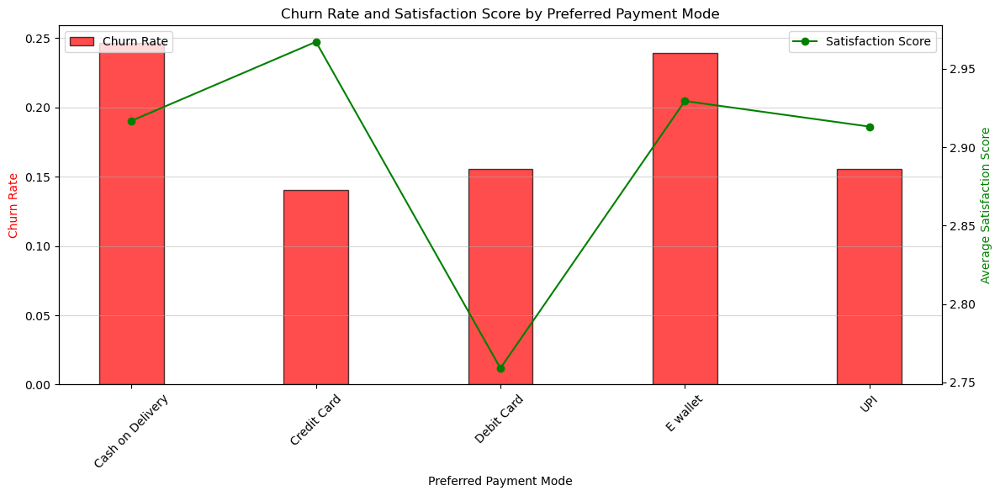

In [17]:
# Calculate churn rate and satisfaction score averages for each preferred payment mode
payment_mode_churn = data.groupby('PreferredPaymentMode')['Churn'].mean()
payment_mode_satisfaction = data.groupby('PreferredPaymentMode')['SatisfactionScore'].mean()

# Combined bar plot for churn rate and satisfaction score by payment mode
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot churn rate as bars
bar_width = 0.35
payment_modes = payment_mode_churn.index
x = range(len(payment_modes))

bars = ax1.bar(x, payment_mode_churn.values, bar_width, label="Churn Rate", color='red', alpha=0.7, edgecolor='k')

# Plot satisfaction score as a line
ax2 = ax1.twinx()
line = ax2.plot(x, payment_mode_satisfaction.values, marker='o', linestyle='-', color='green', label="Satisfaction Score")

# Setting axis labels and titles
ax1.set_xlabel("Preferred Payment Mode")
ax1.set_ylabel("Churn Rate", color='red')
ax2.set_ylabel("Average Satisfaction Score", color='green')
ax1.set_title("Churn Rate and Satisfaction Score by Preferred Payment Mode")

# X-axis tick labels
ax1.set_xticks(x)
ax1.set_xticklabels(payment_modes, rotation=45)

# Adding legends
ax1.legend(loc="upper left")
ax2.legend(loc="upper right")

# Show grid for clarity
ax1.grid(axis='y', alpha=0.5)
plt.tight_layout()
plt.show()


# Payment Mode Analysis

### Churn Rate (Red Bars)
- **Highest**: **Cash on Delivery** and **E-Wallet** users.
- **Lowest**: **Credit Card** users.

### Satisfaction Score (Green Line)
- **Highest**: **Credit Card** users, correlating with low churn.
- **Consistent**: Across most modes but slightly lower for **Debit Card** users.

### Key Takeaway
- **Credit Card** users: Loyal and highly satisfied.
- **Cash on Delivery** and **E-Wallet** users: Moderate satisfaction but high churn; need targeted retention strategies.


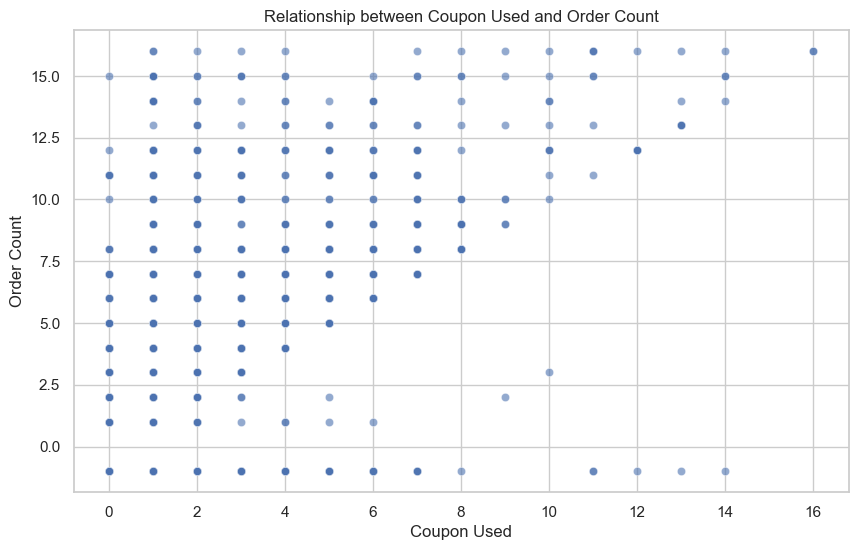

0.6029337150398718

In [77]:
# Plot the relationship between Coupon Used and Order Count without considering Churn
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=data,
    x='CouponUsed',
    y='OrderCount',
    alpha=0.6
)
plt.title("Relationship between Coupon Used and Order Count")
plt.xlabel("Coupon Used")
plt.ylabel("Order Count")
plt.show()

# Calculate correlation between Coupon Used and Order Count
correlation = data[['CouponUsed', 'OrderCount']].corr().iloc[0, 1]
correlation


### Analysis of Coupon Used vs. Order Count

#### Scatterplot:
- The plot shows a **positive relationship** between **Coupon Used** and **Order Count**.
- Customers who use more coupons tend to have a higher number of orders.

#### Correlation:
- The calculated correlation coefficient is **0.60**, indicating a **strong positive linear relationship** between **Coupon Used** and **Order Count**.


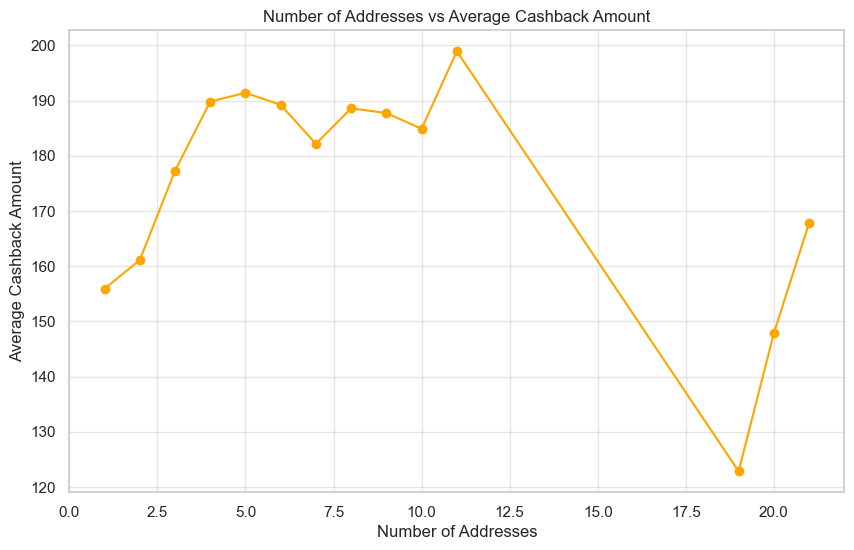

NumberOfAddress
1     155.912644
2     161.098557
3     177.281074
4     189.811271
5     191.402905
6     189.218058
7     182.162374
8     188.589378
9     187.739511
10    184.878037
11    198.928667
19    122.850000
20    147.850000
21    167.820000
Name: CashbackAmount, dtype: float64

In [62]:
# Recomputing the analysis to ensure values are correct

# Grouping data by number of addresses to find average cashback
address_vs_cashback = data.groupby('NumberOfAddress')['CashbackAmount'].mean()

# Plotting the relationship
plt.figure(figsize=(10, 6))
plt.plot(address_vs_cashback.index, address_vs_cashback.values, marker='o', linestyle='-', color='orange')
plt.title("Number of Addresses vs Average Cashback Amount")
plt.xlabel("Number of Addresses")
plt.ylabel("Average Cashback Amount")
plt.grid(alpha=0.5)
plt.show()

# Displaying values for reference
address_vs_cashback


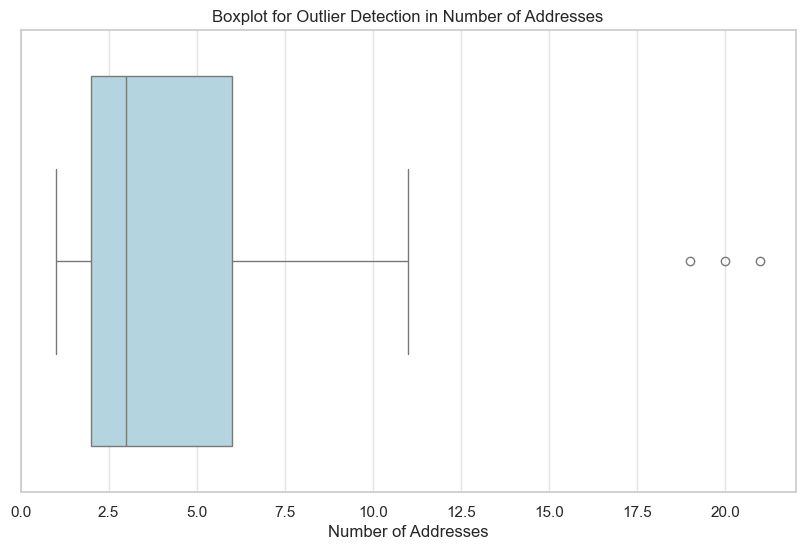

In [63]:
# Plotting the boxplot correctly to visualize outliers in 'NumberOfAddress'
plt.figure(figsize=(10, 6))
sns.boxplot(x=data['NumberOfAddress'], color='lightblue')
plt.title("Boxplot for Outlier Detection in Number of Addresses")
plt.xlabel("Number of Addresses")
plt.grid(axis='x', alpha=0.5)
plt.show()


# Number of Addresses vs Cashback Amount

### Observations
1. **Increasing Trend**:
   - Cashback amount generally increases with the number of addresses from **1 address (\~155.91)** to **5 addresses (\~191.40)**.
   - Indicates that customers with more addresses might be receiving higher cashback due to higher activity or engagement.

2. **Decline Beyond 5 Addresses**:
   - Cashback stabilizes and slightly decreases for customers with **6 or more addresses**.
   - For **19-21 addresses**, cashback fluctuates, possibly due to fewer customers in these groups.

### Key Takeaway
- Outlier is a concern because having more registered address is unusual.
- Cashback incentives are positively correlated with the number of addresses up to **5**, reflecting higher engagement.
- Beyond this point, the relationship weakens, suggesting diminishing returns or a smaller sample size.

Would you like to explore any specific range or dig deeper into this pattern? Let me know!


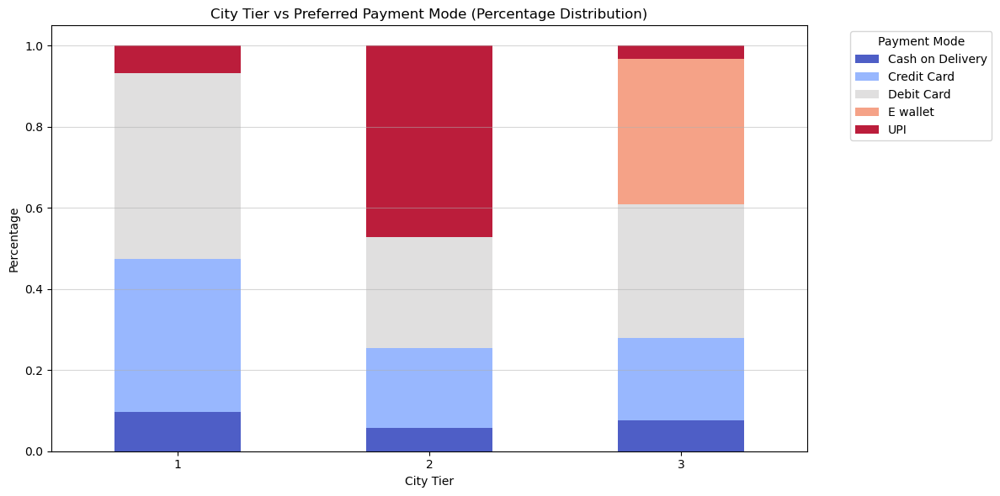

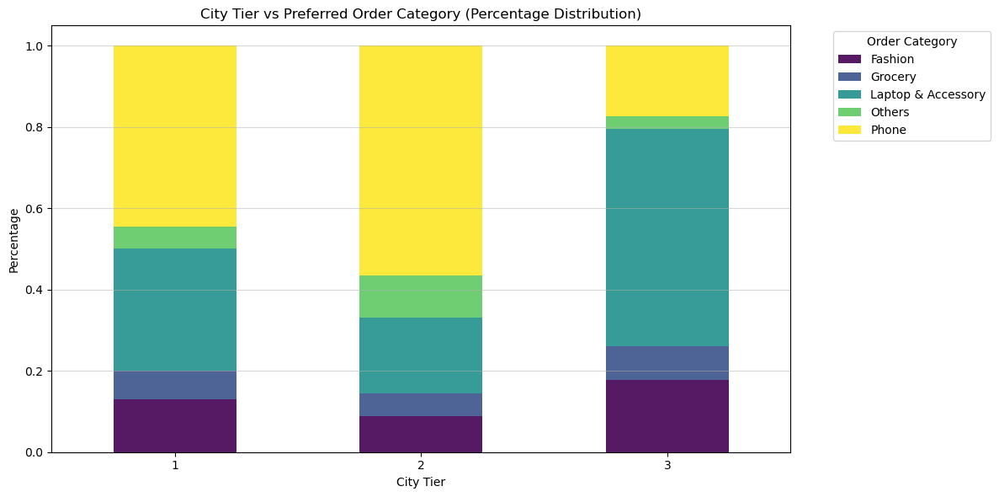

(PreferredPaymentMode  Cash on Delivery  Credit Card  Debit Card  E wallet  \
 CityTier                                                                    
 1                             0.097878     0.376112    0.457563       NaN   
 2                             0.056995     0.196891    0.274611       NaN   
 3                             0.076336     0.203817    0.329771  0.357252   
 
 PreferredPaymentMode       UPI  
 CityTier                        
 1                     0.068446  
 2                     0.471503  
 3                     0.032824  ,
 PreferedOrderCat   Fashion   Grocery  Laptop & Accessory    Others     Phone
 CityTier                                                                    
 1                 0.129363  0.070157            0.301164  0.054757  0.444559
 2                 0.088083  0.056995            0.186528  0.103627  0.564767
 3                 0.177863  0.083206            0.535115  0.029771  0.174046)

In [18]:
# Analyze the relationship between CityTier and Preferred Payment Mode (percentage distribution)
citytier_payment_mode = data.groupby(['CityTier', 'PreferredPaymentMode']).size().unstack().apply(lambda x: x / x.sum(), axis=1)

# Plot the relationship between CityTier and Preferred Payment Mode
citytier_payment_mode.plot(kind='bar', stacked=True, figsize=(12, 6), cmap='coolwarm', alpha=0.9)
plt.title("City Tier vs Preferred Payment Mode (Percentage Distribution)")
plt.xlabel("City Tier")
plt.ylabel("Percentage")
plt.xticks(rotation=0)
plt.legend(title="Payment Mode", bbox_to_anchor=(1.05, 1))
plt.grid(axis='y', alpha=0.5)
plt.tight_layout()
plt.show()

# Analyze the relationship between CityTier and Preferred Order Category (percentage distribution)
citytier_order_cat = data.groupby(['CityTier', 'PreferedOrderCat']).size().unstack().apply(lambda x: x / x.sum(), axis=1)

# Plot the relationship between CityTier and Preferred Order Category
citytier_order_cat.plot(kind='bar', stacked=True, figsize=(12, 6), cmap='viridis', alpha=0.9)
plt.title("City Tier vs Preferred Order Category (Percentage Distribution)")
plt.xlabel("City Tier")
plt.ylabel("Percentage")
plt.xticks(rotation=0)
plt.legend(title="Order Category", bbox_to_anchor=(1.05, 1))
plt.grid(axis='y', alpha=0.5)
plt.tight_layout()
plt.show()

# Display the underlying values for reference
citytier_payment_mode, citytier_order_cat


# City Tier Analysis

### Payment Method Preferences
- **Tier 1**: Mostly use **Debit (45.7%)** and **Credit Cards (37.6%)**, minimal **Cash on Delivery (9.8%)**.
- **Tier 2**: High **UPI (48.1%)** use, moderate **Debit (26.9%)** and **Credit Cards (19.6%)**.
- **Tier 3**: Prefer **E-Wallet (35.7%)** and **Debit Cards (33.1%)**, some **Cash on Delivery (7.7%)**.

### Order Category Preferences
- **Tier 1**: Dominated by **Phone (44.4%)** and **Laptop & Accessory (30.1%)**.
- **Tier 2**: Heavy preference for **Phone (56.6%)**.
- **Tier 3**: Focus on **Laptop & Accessory (53.7%)**, lesser for **Phones (17.2%)**.

### Insights
- **Tier 1**: Modern payment methods dominate, tech categories preferred.
- **Tier 2 & 3**: Digital payments (UPI/E-Wallets) thrive, with varied order preferences.
- **Grocery**: Least popular across all tiers, signaling growth potential.


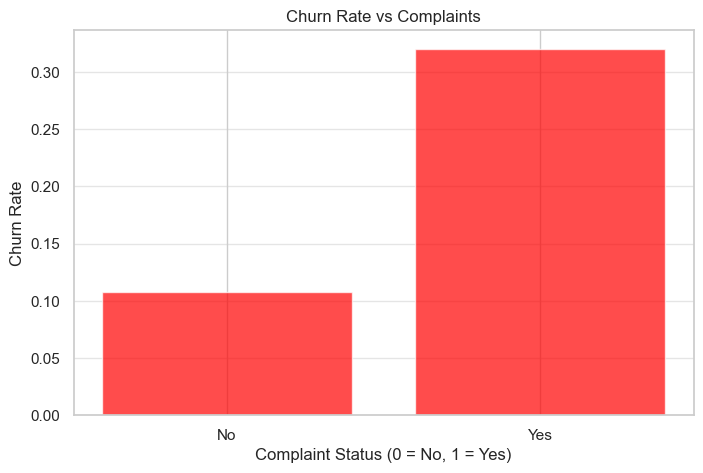

In [48]:
# Plot churn rate against complaints
complain_churn = data.groupby('Complain')['Churn'].mean()
plt.figure(figsize=(8, 5))
plt.bar(complain_churn.index, complain_churn.values, color='red', alpha=0.7)
plt.title("Churn Rate vs Complaints")
plt.xlabel("Complaint Status (0 = No, 1 = Yes)")
plt.ylabel("Churn Rate")
plt.xticks([0, 1], ['No', 'Yes'])
plt.grid(axis='y', alpha=0.5)
plt.show()

### Churn Rate vs Complaints
- **With Complaints**: Churn rate is significantly higher (**32.1%**).
- **Without Complaints**: Churn rate is much lower (**10.8%**).

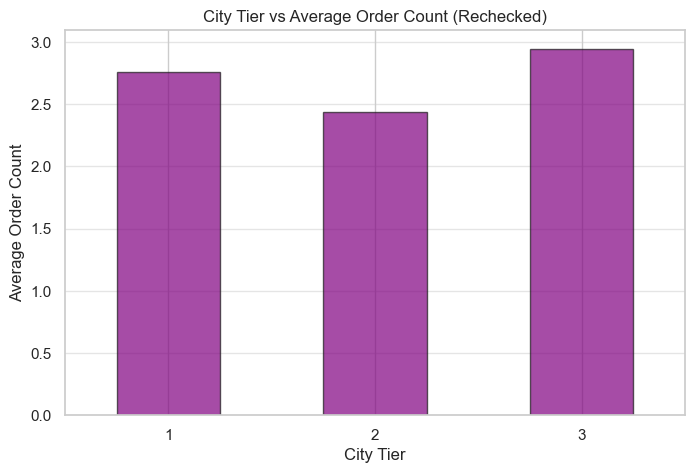

In [50]:
# Rechecking the computation of the relationship between CityTier and Order Count
citytier_order_count_recheck = data.groupby('CityTier')['OrderCount'].mean()

# Display the rechecked values
citytier_order_count_recheck

# Replotting the relationship between City Tier and Order Count using rechecked values
plt.figure(figsize=(8, 5))
citytier_order_count_recheck.plot(kind='bar', color='purple', edgecolor='k', alpha=0.7)
plt.title("City Tier vs Average Order Count (Rechecked)")
plt.xlabel("City Tier")
plt.ylabel("Average Order Count")
plt.xticks(rotation=0)
plt.grid(axis='y', alpha=0.5)
plt.show()



# City Tier vs Order Count

### Observations
1. **Tier 3**: Customers place the highest average number of orders (**2.95 orders**).
2. **Tier 1**: Slightly lower at **2.76 orders**.
3. **Tier 2**: Lowest activity with **2.43 orders**.

### Key Takeaway
- **Tier 3** is the most active in placing orders.
- **Tier 2** customers need targeted engagement strategies to boost their order frequency.


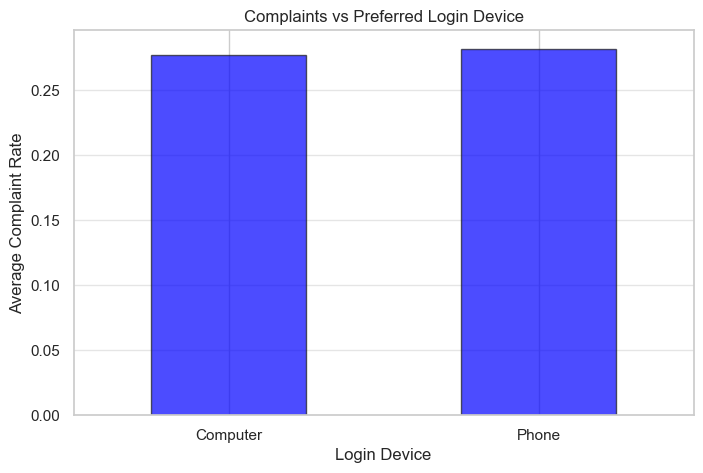

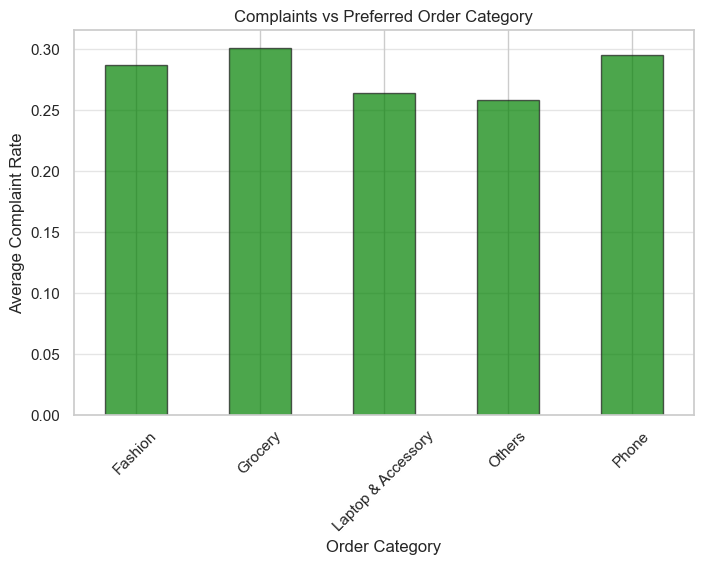

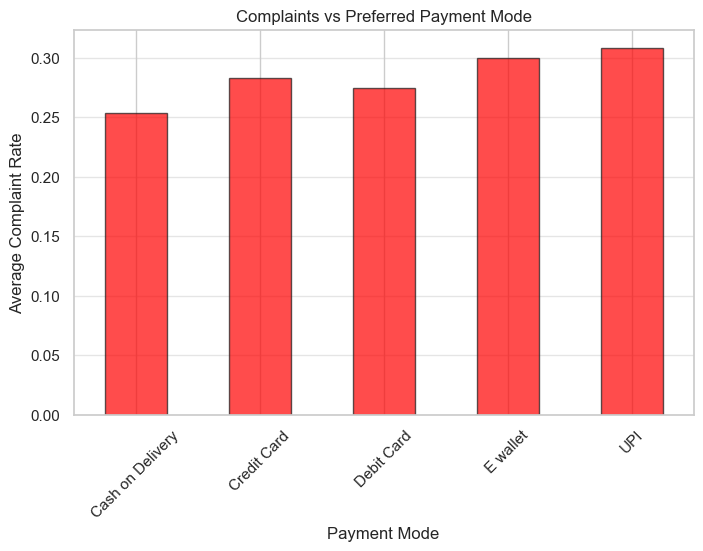

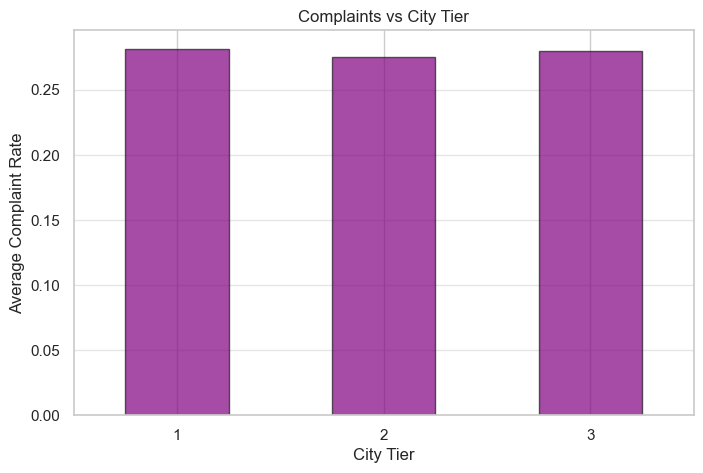

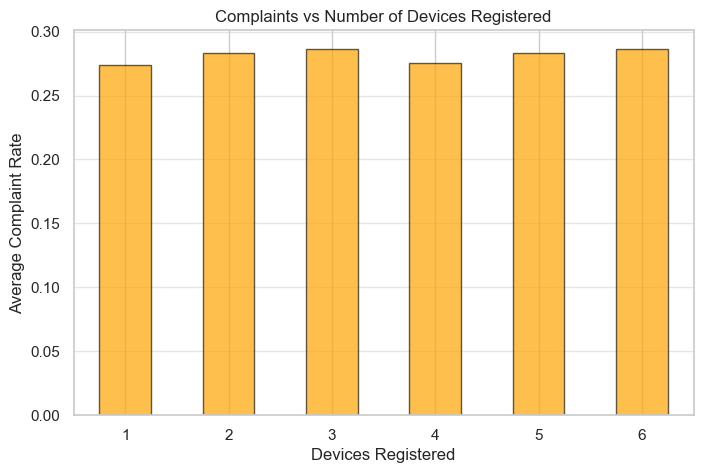

In [52]:
# Recomputing values for plots

# Complaints vs Preferred Login Device
complain_device = data.groupby('PreferredLoginDevice')['Complain'].mean()

# Complaints vs Preferred Order Category
complain_order_cat = data.groupby('PreferedOrderCat')['Complain'].mean()

# Complaints vs Preferred Payment Mode
complain_payment_mode = data.groupby('PreferredPaymentMode')['Complain'].mean()

# Complaints vs City Tier
complain_city = data.groupby('CityTier')['Complain'].mean()

# Complaints vs Number of Devices Registered
complain_devices = data.groupby('NumberOfDeviceRegistered')['Complain'].mean()

# Re-plotting with recomputed values

# Complaints vs Preferred Login Device
plt.figure(figsize=(8, 5))
complain_device.plot(kind='bar', color='blue', edgecolor='k', alpha=0.7)
plt.title("Complaints vs Preferred Login Device")
plt.xlabel("Login Device")
plt.ylabel("Average Complaint Rate")
plt.xticks(rotation=0)
plt.grid(axis='y', alpha=0.5)
plt.show()

# Complaints vs Preferred Order Category
plt.figure(figsize=(8, 5))
complain_order_cat.plot(kind='bar', color='green', edgecolor='k', alpha=0.7)
plt.title("Complaints vs Preferred Order Category")
plt.xlabel("Order Category")
plt.ylabel("Average Complaint Rate")
plt.xticks(rotation=45)
plt.grid(axis='y', alpha=0.5)
plt.show()

# Complaints vs Preferred Payment Mode
plt.figure(figsize=(8, 5))
complain_payment_mode.plot(kind='bar', color='red', edgecolor='k', alpha=0.7)
plt.title("Complaints vs Preferred Payment Mode")
plt.xlabel("Payment Mode")
plt.ylabel("Average Complaint Rate")
plt.xticks(rotation=45)
plt.grid(axis='y', alpha=0.5)
plt.show()

# Complaints vs City Tier
plt.figure(figsize=(8, 5))
complain_city.plot(kind='bar', color='purple', edgecolor='k', alpha=0.7)
plt.title("Complaints vs City Tier")
plt.xlabel("City Tier")
plt.ylabel("Average Complaint Rate")
plt.xticks(rotation=0)
plt.grid(axis='y', alpha=0.5)
plt.show()

# Complaints vs Number of Devices Registered
plt.figure(figsize=(8, 5))
complain_devices.plot(kind='bar', color='orange', edgecolor='k', alpha=0.7)
plt.title("Complaints vs Number of Devices Registered")
plt.xlabel("Devices Registered")
plt.ylabel("Average Complaint Rate")
plt.xticks(rotation=0)
plt.grid(axis='y', alpha=0.5)
plt.show()


### Complaints vs Preferred Login Device
- **Computer Users**: Complaint rate is **27.7%**.
- **Phone Users**: Slightly higher complaint rate at **28.2%**.

### Complaints vs Preferred Order Category
- **Highest Complaints**:
  - **Grocery**: **30.0%**
  - **Phone**: **29.5%**
- **Lowest Complaints**:
  - **Others**: **25.8%**
  - **Laptop & Accessory**: **26.4%**

### Complaints vs Preferred Payment Mode
- **Highest Complaints**: **UPI** users (**30.8%**).
- **Moderate Complaints**: **E-Wallet (30.0%)** and **Credit Card (28.3%)** users.
- **Lowest Complaints**: **Cash on Delivery** users (**25.4%**).

### Complaints vs City Tier
- **Tier 1**: Complaint rate is **28.2%**.
- **Tier 2**: Slightly lower at **27.5%**.
- **Tier 3**: Slightly higher at **27.9%**.

### Complaints vs Number of Devices Registered
- **Lowest Complaints**: **1 device** (**27.4%**).
- **Highest Complaints**: **6 devices** (**28.7%**).

### Key Takeaways
- **Order Categories** like **Grocery** and **Phone** have the highest complaint rates; improvements in service here are crucial.
- **UPI users** report the highest complaints among payment modes, likely needing smoother experiences.
- **Multi-device users** (especially 6 devices) experience more complaints, suggesting a need for better multi-device support.
- **City Tiers** are fairly balanced, but **Tier 1** slightly edges higher complaints, potentially due to higher expectations or complexities.


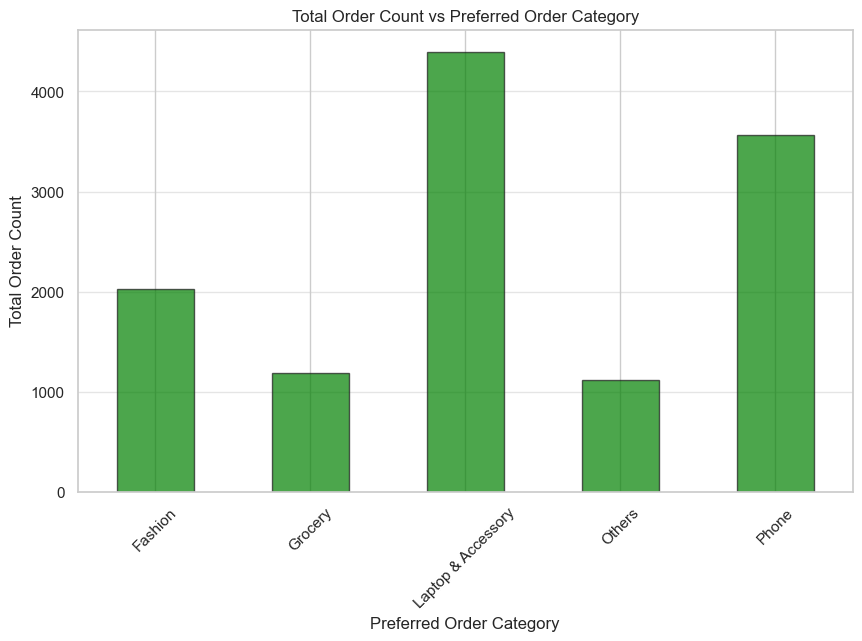

PreferedOrderCat
Fashion               2026.0
Grocery               1191.0
Laptop & Accessory    4396.0
Others                1114.0
Phone                 3564.0
Name: OrderCount, dtype: float64

In [61]:
# Analyze the total order count for each preferred order category
total_order_count_category = data.groupby('PreferedOrderCat')['OrderCount'].sum()

# Plot the total order count
plt.figure(figsize=(10, 6))
total_order_count_category.plot(kind='bar', color='green', edgecolor='k', alpha=0.7)
plt.title("Total Order Count vs Preferred Order Category")
plt.xlabel("Preferred Order Category")
plt.ylabel("Total Order Count")
plt.xticks(rotation=45)
plt.grid(axis='y', alpha=0.5)
plt.show()

# Display the underlying values for reference
total_order_count_category



# Total Order Count vs Preferred Order Category

### Observations
- **Highest Total Orders**:
  - **Laptop & Accessory**: Total of **4,396 orders**.
  - **Phone**: Total of **3,564 orders**.
- **Lowest Total Orders**:
  - **Grocery**: Total of **1,191 orders**.
  - **Others**: Total of **1,114 orders**.

### Key Takeaway
- **Laptop & Accessory** and **Phone** categories dominate in total orders, indicating their popularity.
- **Grocery** and **Others** have fewer total orders, possibly reflecting niche or less frequent purchasing behaviors.
- Total orders highlight **overall category contribution**, contrasting with average order counts, which reflect **per-customer behavior**.


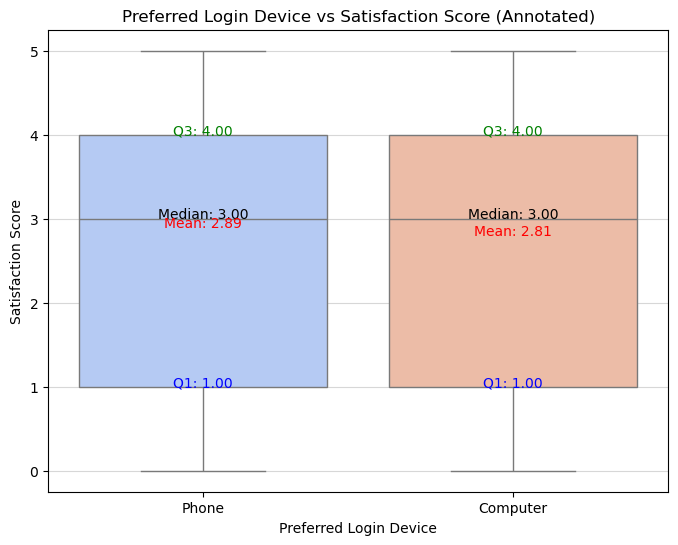

,count,mean,std,min,25%,50%,75%,max
PreferredLoginDevice,,,,,,,,
Computer,1292.0,2.807276,1.518543,0.0,1.0,3.0,4.0,5.0
Phone,3133.0,2.894350,1.541676,0.0,1.0,3.0,4.0,5.0


In [20]:
# Replot with accurate annotations including median, quartiles, and mean
plt.figure(figsize=(8, 6))
boxplot = sns.boxplot(x='PreferredLoginDevice', y='SatisfactionScore', data=data, palette='coolwarm')

# Add annotations for median, quartiles, and mean
for i, device in enumerate(data['PreferredLoginDevice'].unique()):
    stats = data[data['PreferredLoginDevice'] == device]['SatisfactionScore'].describe()
    mean = data[data['PreferredLoginDevice'] == device]['SatisfactionScore'].mean()
    plt.text(i, stats['50%'], f"Median: {stats['50%']:.2f}", horizontalalignment='center', color='black')
    plt.text(i, stats['25%'], f"Q1: {stats['25%']:.2f}", horizontalalignment='center', color='blue')
    plt.text(i, stats['75%'], f"Q3: {stats['75%']:.2f}", horizontalalignment='center', color='green')
    plt.text(i, mean, f"Mean: {mean:.2f}", horizontalalignment='center', color='red')

plt.title("Preferred Login Device vs Satisfaction Score (Annotated)")
plt.xlabel("Preferred Login Device")
plt.ylabel("Satisfaction Score")
plt.grid(axis='y', alpha=0.5)
plt.show()


# Recheck the statistics for accuracy
stats_by_device = data.groupby('PreferredLoginDevice')['SatisfactionScore'].describe()

# Display the stats to verify against the plot
stats_by_device



Both groups have a median satisfaction score of 3 (neutral).
Phone users show slightly higher mean satisfaction (2.92 vs. 2.83) and tighter clustering between Q1 and Q3.
Computer users have more spread below Q1, indicating a subset with lower satisfaction.

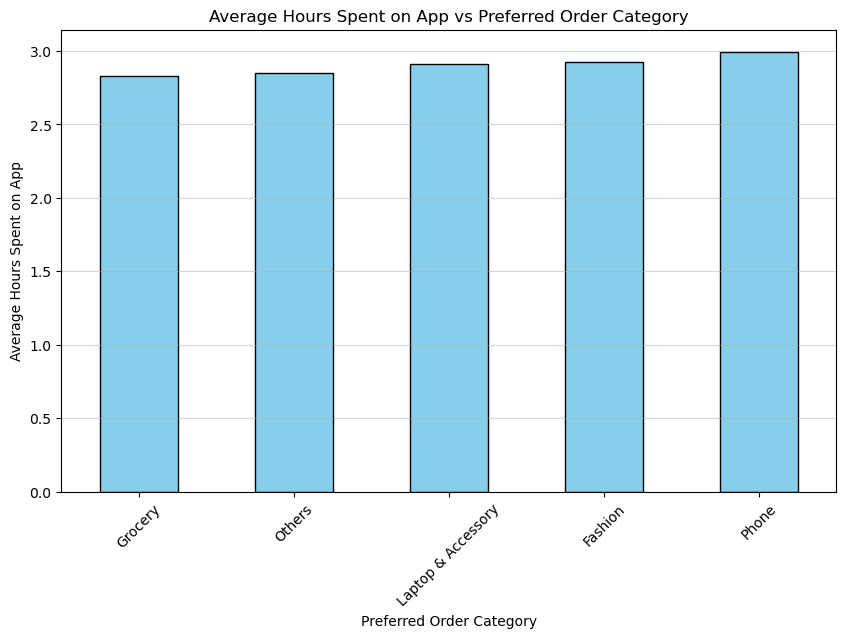

PreferedOrderCat
Grocery               2.827692
Others                2.853211
Laptop & Accessory    2.910959
Fashion               2.921850
Phone                 2.995186
Name: HourSpendOnApp, dtype: float64

In [21]:
# Calculate average hours spent on the app for each preferred order category
hours_vs_category = data.groupby('PreferedOrderCat')['HourSpendOnApp'].mean().sort_values()

# Plot the relationship
plt.figure(figsize=(10, 6))
hours_vs_category.plot(kind='bar', color='skyblue', edgecolor='k')
plt.title("Average Hours Spent on App vs Preferred Order Category")
plt.xlabel("Preferred Order Category")
plt.ylabel("Average Hours Spent on App")
plt.xticks(rotation=45)
plt.grid(axis='y', alpha=0.5)
plt.show()

# Display the underlying values for reference
hours_vs_category


Utility Categories (e.g., Grocery) involve quicker interactions, while discretionary items (e.g., Phones) require more time, likely for comparison or research.
Tailored app experiences based on category preferences (e.g., faster navigation for grocery and detailed product info for phones) could improve user satisfaction and retention.

tes

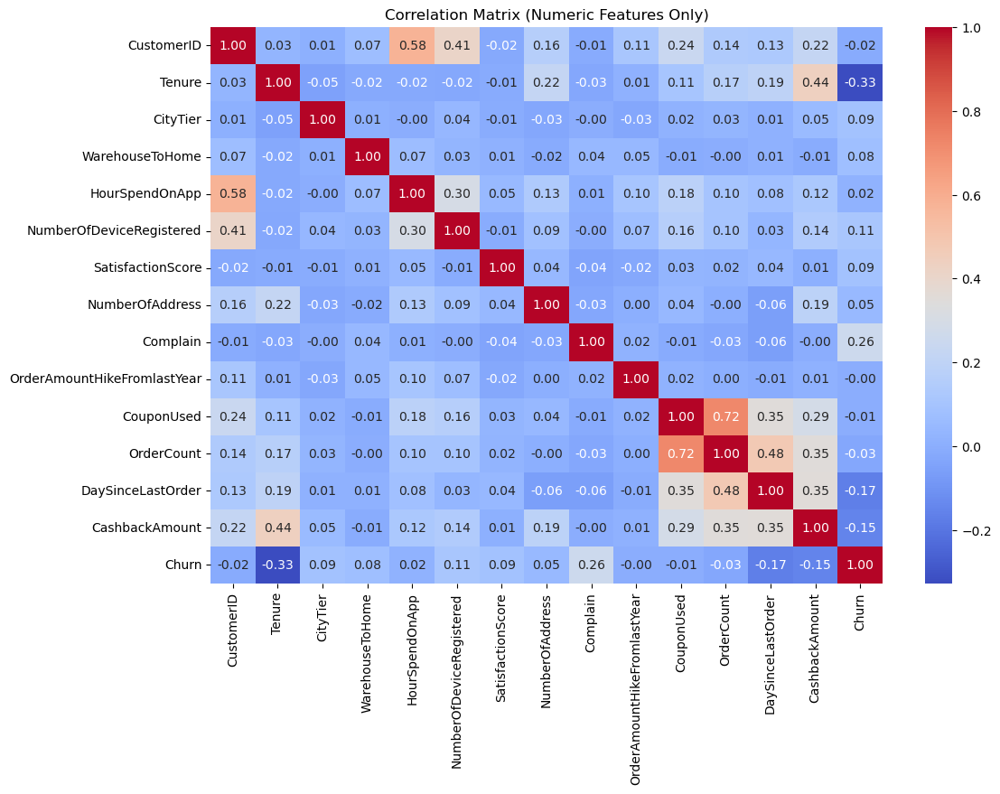

In [22]:
# Select only numeric columns
numeric_data = data.select_dtypes(include=['float64', 'int64'])

# Compute the correlation matrix
correlation_matrix = numeric_data.corr()

# Plot the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix (Numeric Features Only)")
plt.show()

In [23]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4425 entries, 0 to 4660
Data columns (total 19 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   4425 non-null   int64  
 1   Tenure                       4213 non-null   float64
 2   PreferredLoginDevice         4425 non-null   object 
 3   CityTier                     4425 non-null   int64  
 4   WarehouseToHome              4222 non-null   float64
 5   PreferredPaymentMode         4425 non-null   object 
 6   HourSpendOnApp               4230 non-null   float64
 7   NumberOfDeviceRegistered     4425 non-null   int64  
 8   PreferedOrderCat             4425 non-null   object 
 9   SatisfactionScore            4425 non-null   float64
 10  NumberOfAddress              4425 non-null   int64  
 11  Complain                     4407 non-null   float64
 12  OrderAmountHikeFromlastYear  4202 non-null   float64
 13  CouponUsed             

In [24]:
y_profile = ProfileReport(data, title='Churn Data')
y_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [25]:
# Droping cashback rows as it is less than 0.8%

 # Drop rows where CashbackAmount is missing
data = data.dropna(subset=['CashbackAmount'])

In [26]:
# Predictiong tenure using cashback and churn as it has significant possitive correlation 

# Prepare data
features = ['CashbackAmount']  # Choose predictors
regression_data = data[features + ['Tenure']].dropna(subset=['Tenure'])  # Use only rows with Tenure available

# Split into training and testing sets
X = regression_data[features]
y = regression_data['Tenure']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train regression model
regressor = LinearRegression()
regressor.fit(X_train, y_train)

# Predict on the test set
y_pred = regressor.predict(X_test)

# Evaluate model performance
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"R² Score: {r2:.2f}")


Mean Absolute Error (MAE): 6.16
Mean Squared Error (MSE): 59.58
R² Score: 0.18


In [27]:
from sklearn.ensemble import GradientBoostingRegressor

# Add more features based on correlation analysis
# Prepare data
features = ['CashbackAmount']  # Choose predictors
regression_data = data[features + ['Tenure']].dropna(subset=['Tenure'])  # Use only rows with Tenure availableX = data[features]

# Split into training and testing sets
X = regression_data[features]
y = regression_data['Tenure']

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train Gradient Boosting Regressor
gb_model = GradientBoostingRegressor(random_state=42, n_estimators=200, learning_rate=0.1, max_depth=4)
gb_model.fit(X_train, y_train)
y_pred_gb = gb_model.predict(X_test)

# Evaluate Performance
mae = mean_absolute_error(y_test, y_pred_gb)
mse = mean_squared_error(y_test, y_pred_gb)
r2 = r2_score(y_test, y_pred_gb)

print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"R² Score: {r2:.2f}")

Mean Absolute Error (MAE): 5.75
Mean Squared Error (MSE): 52.78
R² Score: 0.27


### Tried Regression and other types but model is not giving good result due to weak correlation

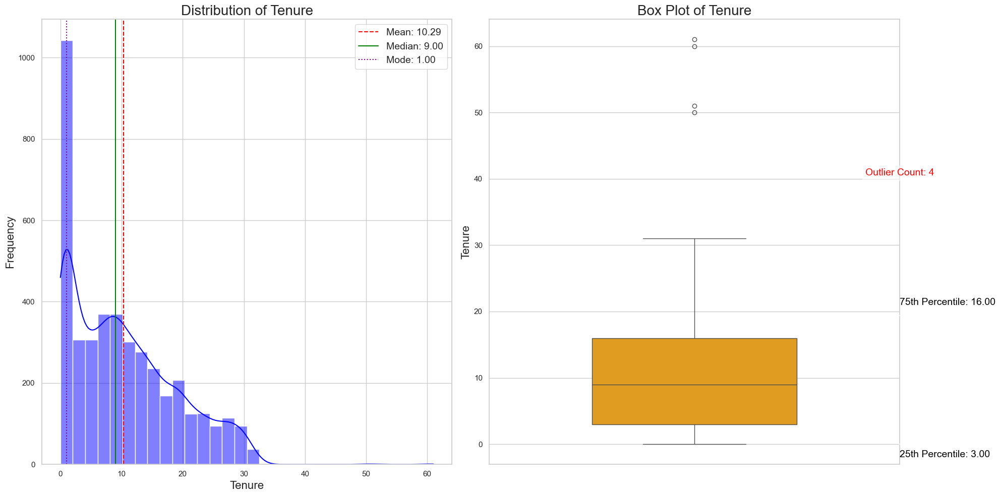

In [28]:
# Set plot style
sns.set(style="whitegrid")

# Create a figure for the plots with larger size
fig, axes = plt.subplots(1, 2, figsize=(20, 10))

# Plot 1: Distribution Plot of Tenure
sns.histplot(data['Tenure'], bins=30, kde=True, color='blue', ax=axes[0])
axes[0].set_title("Distribution of Tenure", fontsize=20)
axes[0].set_xlabel("Tenure", fontsize=16)
axes[0].set_ylabel("Frequency", fontsize=16)
axes[0].axvline(data['Tenure'].mean(), color='red', linestyle='--', label=f"Mean: {data['Tenure'].mean():.2f}")
axes[0].axvline(data['Tenure'].median(), color='green', linestyle='-', label=f"Median: {data['Tenure'].median():.2f}")
axes[0].axvline(data['Tenure'].mode()[0], color='purple', linestyle=':', label=f"Mode: {data['Tenure'].mode()[0]:.2f}")
axes[0].legend(fontsize=14)

# Plot 2: Vertical Box Plot of Tenure
sns.boxplot(y=data['Tenure'], color='orange', ax=axes[1], width=0.5)
axes[1].set_title("Box Plot of Tenure", fontsize=20)
axes[1].set_ylabel("Tenure", fontsize=16)

# Annotating box plot with statistics
q1 = data['Tenure'].quantile(0.25)
q3 = data['Tenure'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = data[(data['Tenure'] < lower_bound) | (data['Tenure'] > upper_bound)]

# Adding annotations for percentiles and outlier count
axes[1].annotate(
    f"25th Percentile: {q1:.2f}",
    xy=(0.3, q1),
    xytext=(0.5, q1 - 5),
    arrowprops=dict(facecolor='black', arrowstyle="->"),
    fontsize=14,
    color="black",
)
axes[1].annotate(
    f"75th Percentile: {q3:.2f}",
    xy=(0.3, q3),
    xytext=(0.5, q3 + 5),
    arrowprops=dict(facecolor='black', arrowstyle="->"),
    fontsize=14,
    color="black",
)
axes[1].text(
    0.5,
    upper_bound + 5,
    f"Outlier Count: {len(outliers)}",
    fontsize=14,
    color="red",
    bbox=dict(facecolor="white", alpha=0.5),
    ha="center",
)

# Adjust layout for better alignment
plt.tight_layout()

# Display the plots
plt.show()

#### Setting up -1 for empty tenures and creating a new feature Tennure_Missing indicator

In [29]:
# Setting up -1 for empty tenures and creating a new feature `Tenure_Missing` indicator
data['Tenure_Missing'] = data['Tenure'].isnull().astype(int)  # Indicator for missing Tenure
data['Tenure'].fillna(-1, inplace=True)  # Replace missing Tenure values with -1

# Display a few rows to verify
data[['Tenure', 'Tenure_Missing']].head()
# Update 'OrderCount_Missing' with meaningful text labels
data['Tenure_Missing'] = data['Tenure_Missing'].replace({0: 'Tenure_Missing_False', 1: 'Tenure_Missing_True'})

# Verify the updated column
data[['Tenure', 'Tenure_Missing']].head()


,Tenure,Tenure_Missing
0,5.0,Tenure_Missing_False
1,2.0,Tenure_Missing_False
2,13.0,Tenure_Missing_False
3,-1.0,Tenure_Missing_True
4,19.0,Tenure_Missing_False


#### WarehouseToHome is not having significant realtionship with any variable.
#### The data is right skewed as well and contains significant percenatage of missing values(4.6). Therefore imputing with median

In [74]:
# Impute missing values in the 'WarehouseToHome' column with the median
data['WarehouseToHome'].fillna(data['WarehouseToHome'].median(), inplace=True)

# Verify if there are any missing values left in the 'WarehouseToHome' column
missing_count = data['WarehouseToHome'].isnull().sum()

# Display the result
print(f"Number of missing values in 'WarehouseToHome' after imputation: {missing_count}")
data['WarehouseToHome'].describe()


Number of missing values in 'WarehouseToHome' after imputation: 0


count    4389.000000
mean       15.611301
std         8.394160
min         5.000000
25%         9.000000
50%        14.000000
75%        20.000000
max       127.000000
Name: WarehouseToHome, dtype: float64

#### Imputing HoursSpendOn App by median after checking the statistical measure for the entire column and as well as number of devices registered(since had some correlation.)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


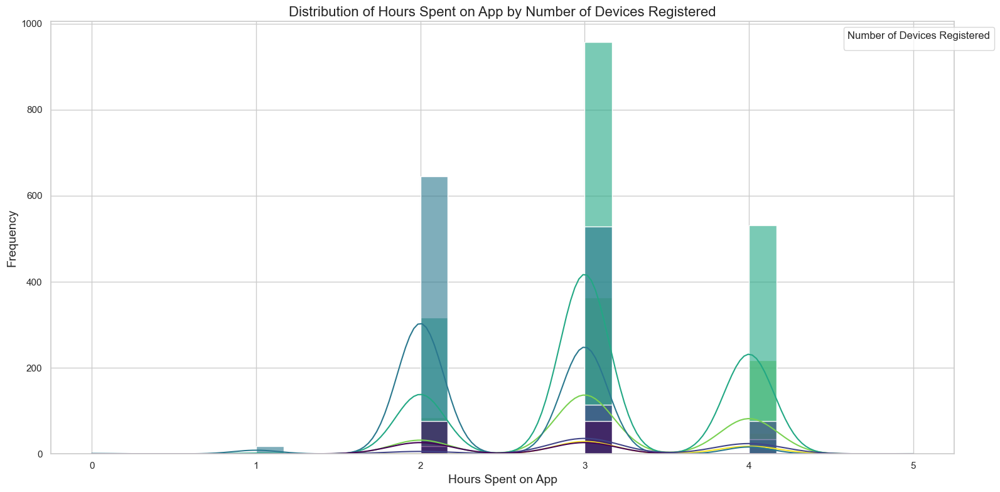

In [31]:
from scipy.stats import kurtosis, skew

# Group the data by 'NumberOfDeviceRegistered' and calculate the summary statistics for 'HourSpendOnApp'
grouped_stats = data.groupby('NumberOfDeviceRegistered')['HourSpendOnApp'].agg(
    Mean='mean',
    Median='median',
    Mode=lambda x: x.mode()[0] if not x.mode().empty else None,
    Skewness=lambda x: skew(x, bias=False),
    Kurtosis=lambda x: kurtosis(x, bias=False)
).reset_index()

# Distribution: Histogram of 'HourSpendOnApp' grouped by 'NumberOfDeviceRegistered'
plt.figure(figsize=(16, 8))
sns.histplot(data=data, x='HourSpendOnApp', hue='NumberOfDeviceRegistered', kde=True, palette='viridis', bins=30, alpha=0.6)
plt.title("Distribution of Hours Spent on App by Number of Devices Registered", fontsize=16)
plt.xlabel("Hours Spent on App", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.legend(title="Number of Devices Registered", fontsize=12, bbox_to_anchor=(1.05, 1))
plt.tight_layout()
plt.show()

In [32]:
# Impute missing values in the 'HoursSpendOnApp' column with the median
data['HourSpendOnApp'].fillna(data['HourSpendOnApp'].median(), inplace=True)

#### OrderCount

In [33]:
# Impute missing values in the 'OrderCount' column with the median
data['OrderCount_Missing'] = data['OrderCount'].isnull().astype(int)  # Indicator for missing Tenure
data['OrderCount'].fillna(-1, inplace=True)  # Replace missing Tenure values with -1

# Display a few rows to verify
data[['OrderCount', 'OrderCount_Missing']].head()
# Update 'OrderCount_Missing' with meaningful text labels
data['OrderCount_Missing'] = data['OrderCount_Missing'].replace({0: 'OrderCount_Missing_False', 1: 'OrderCount_Missing_True'})

# Verify the updated column
data[['OrderCount', 'OrderCount_Missing']].head()


,OrderCount,OrderCount_Missing
0,2.0,OrderCount_Missing_False
1,1.0,OrderCount_Missing_False
2,4.0,OrderCount_Missing_False
3,1.0,OrderCount_Missing_False
4,2.0,OrderCount_Missing_False


In [34]:
data[data['OrderCount'] == -1]

,CustomerID,Tenure,PreferredLoginDevice,CityTier,WarehouseToHome,PreferredPaymentMode,HourSpendOnApp,NumberOfDeviceRegistered,PreferedOrderCat,SatisfactionScore,...,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount,Churn,SatisfactionScoreText,Tenure_Missing,OrderCount_Missing
52,51890,20.0,Computer,3,9.0,Credit Card,2.0,3,Grocery,3.0,...,1.0,12.0,1.0,-1.0,13.0,237.70,0.0,Neutral,Tenure_Missing_False,OrderCount_Missing_True
65,50091,14.0,Phone,3,12.0,Debit Card,3.0,3,Fashion,2.0,...,1.0,18.0,0.0,-1.0,0.0,235.91,0.0,Dissatisfied,Tenure_Missing_False,OrderCount_Missing_True
93,54412,13.0,Computer,1,9.0,Cash on Delivery,2.0,4,Fashion,3.0,...,0.0,26.0,7.0,-1.0,9.0,234.38,0.0,Neutral,Tenure_Missing_False,OrderCount_Missing_True
110,51781,0.0,Phone,1,21.0,Credit Card,2.0,3,Fashion,3.0,...,1.0,12.0,3.0,-1.0,7.0,236.10,1.0,Neutral,Tenure_Missing_False,OrderCount_Missing_True
146,52778,10.0,Phone,1,16.0,Debit Card,2.0,1,Fashion,1.0,...,1.0,25.0,5.0,-1.0,8.0,237.44,0.0,Very Dissatisfied,Tenure_Missing_False,OrderCount_Missing_True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4593,51436,13.0,Computer,1,6.0,Debit Card,3.0,4,Grocery,4.0,...,0.0,22.0,5.0,-1.0,11.0,235.03,0.0,Satisfied,Tenure_Missing_False,OrderCount_Missing_True
4599,54911,18.0,Phone,3,35.0,Credit Card,3.0,2,Grocery,1.0,...,1.0,19.0,5.0,-1.0,12.0,258.20,0.0,Very Dissatisfied,Tenure_Missing_False,OrderCount_Missing_True
4607,50391,-1.0,Computer,1,9.0,Debit Card,2.0,4,Phone,3.0,...,0.0,18.0,1.0,-1.0,0.0,112.81,0.0,Neutral,Tenure_Missing_True,OrderCount_Missing_True
4621,51614,18.0,Phone,1,26.0,Credit Card,3.0,3,Grocery,1.0,...,1.0,14.0,2.0,-1.0,10.0,234.96,0.0,Very Dissatisfied,Tenure_Missing_False,OrderCount_Missing_True


#### OrderHike Imputation based on median value

In [35]:
# Impute missing values in the 'OrderAmountHikeFromlastYear' column with the median
data['OrderAmountHikeFromlastYear'].fillna(data['OrderAmountHikeFromlastYear'].median(), inplace=True)

In [36]:
# Impute missing values in the 'CouponUsed' column with the median
data['CouponUsed'].fillna(data['CouponUsed'].median(), inplace=True)

In [37]:
# Impute missing values in the 'OrderCount' column with the median
data['OrderCount'].fillna(data['OrderCount'].median(), inplace=True)

In [38]:
# Impute missing values in the 'DaySinceLastOrder' column with the median
data['DaySinceLastOrder'].fillna(data['DaySinceLastOrder'].median(), inplace=True)

In [39]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4389 entries, 0 to 4660
Data columns (total 21 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   4389 non-null   int64  
 1   Tenure                       4389 non-null   float64
 2   PreferredLoginDevice         4389 non-null   object 
 3   CityTier                     4389 non-null   int64  
 4   WarehouseToHome              4389 non-null   float64
 5   PreferredPaymentMode         4389 non-null   object 
 6   HourSpendOnApp               4389 non-null   float64
 7   NumberOfDeviceRegistered     4389 non-null   int64  
 8   PreferedOrderCat             4389 non-null   object 
 9   SatisfactionScore            4389 non-null   float64
 10  NumberOfAddress              4389 non-null   int64  
 11  Complain                     4389 non-null   float64
 12  OrderAmountHikeFromlastYear  4389 non-null   float64
 13  CouponUsed             

In [40]:
data.head()

,CustomerID,Tenure,PreferredLoginDevice,CityTier,WarehouseToHome,PreferredPaymentMode,HourSpendOnApp,NumberOfDeviceRegistered,PreferedOrderCat,SatisfactionScore,...,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount,Churn,SatisfactionScoreText,Tenure_Missing,OrderCount_Missing
0,55388,5.0,Phone,1,9.0,Debit Card,4.0,4,Phone,3.0,...,0.0,15.0,2.0,2.0,4.0,159.77,0.0,Neutral,Tenure_Missing_False,OrderCount_Missing_False
1,52565,2.0,Phone,1,15.0,Credit Card,3.0,3,Phone,3.0,...,0.0,17.0,0.0,1.0,2.0,129.74,0.0,Neutral,Tenure_Missing_False,OrderCount_Missing_False
2,50690,13.0,Phone,1,20.0,Credit Card,2.0,4,Others,3.0,...,0.0,15.0,4.0,4.0,9.0,296.26,0.0,Neutral,Tenure_Missing_False,OrderCount_Missing_False
3,52456,-1.0,Phone,1,8.0,Debit Card,3.0,3,Phone,5.0,...,1.0,12.0,1.0,1.0,0.0,120.74,1.0,Very Satisfied,Tenure_Missing_True,OrderCount_Missing_False
4,51153,19.0,Phone,1,8.0,Credit Card,2.0,3,Others,1.0,...,1.0,15.0,1.0,2.0,2.0,293.28,0.0,Very Dissatisfied,Tenure_Missing_False,OrderCount_Missing_False


In [41]:
# Save the cleaned dataset for future use
cleaned_file_path = '/Users/vinoth/Library/Mobile Documents/com~apple~CloudDocs/Job Assignment/Red Cloud Technology/technical_challenge/final_challenge_dataset.csv'
data.to_csv(cleaned_file_path, index=False)


cleaned_file_path

'/Users/vinoth/Library/Mobile Documents/com~apple~CloudDocs/Job Assignment/Red Cloud Technology/technical_challenge/final_challenge_dataset.csv'

In [42]:
y_profile = ProfileReport(data, title='Churn Data')
y_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]